<a href="https://colab.research.google.com/github/Pathakarnav22/Machine-Learning/blob/main/BreastCancer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
pd.pandas.set_option('display.max_columns', None)

In [ ]:
dataset = pd.read_csv('breast-cancer.csv')
dataset.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [ ]:
dataset.shape

(569, 32)

In [ ]:
dataset.isnull()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
565,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
566,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
567,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


**Step - 1 Finding Missing value**


In [ ]:
feature_with_na = [ feature for feature in dataset.columns if dataset[feature].isnull().sum()>1]
for feature in feature_with_na:
  print("{}: {}% missing values".format(feature,np.round(dataset[feature].isnull().mean(),4)))



In [ ]:
dataset['diagnosis'].unique()

array(['M', 'B'], dtype=object)

In [ ]:
featur_with_duplicate = [ feature for feature in dataset.columns if dataset[feature].duplicated().sum()>1]

for feature in featur_with_duplicate:
  print(feature,np.round(dataset[feature].duplicated().mean(),4),'%duplicate ')

diagnosis 0.9965 %duplicate 
radius_mean 0.1986 %duplicate 
texture_mean 0.1582 %duplicate 
perimeter_mean 0.0826 %duplicate 
area_mean 0.0527 %duplicate 
smoothness_mean 0.167 %duplicate 
compactness_mean 0.0562 %duplicate 
concavity_mean 0.0562 %duplicate 
concave points_mean 0.0475 %duplicate 
symmetry_mean 0.2408 %duplicate 
fractal_dimension_mean 0.123 %duplicate 
radius_se 0.051 %duplicate 
texture_se 0.0879 %duplicate 
perimeter_se 0.0633 %duplicate 
area_se 0.0721 %duplicate 
smoothness_se 0.0387 %duplicate 
compactness_se 0.0492 %duplicate 
concavity_se 0.0633 %duplicate 
concave points_se 0.109 %duplicate 
symmetry_se 0.1248 %duplicate 
fractal_dimension_se 0.0422 %duplicate 
radius_worst 0.1968 %duplicate 
texture_worst 0.1019 %duplicate 
perimeter_worst 0.0967 %duplicate 
area_worst 0.0439 %duplicate 
smoothness_worst 0.2777 %duplicate 
compactness_worst 0.0703 %duplicate 
concavity_worst 0.0527 %duplicate 
concave points_worst 0.1353 %duplicate 
symmetry_worst 0.1213 %dupl

In [ ]:
dataset = dataset.drop_duplicates()

In [ ]:
dataset

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,1.1760,1.2560,7.673,158.70,0.010300,0.02891,0.05198,0.02454,0.01114,0.004239,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,0.7655,2.4630,5.203,99.04,0.005769,0.02423,0.03950,0.01678,0.01898,0.002498,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,0.4564,1.0750,3.425,48.55,0.005903,0.03731,0.04730,0.01557,0.01318,0.003892,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,0.7260,1.5950,5.772,86.22,0.006522,0.06158,0.07117,0.01664,0.02324,0.006185,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [ ]:
print("Remaining duplicate rows:", dataset.duplicated().sum())
print("New shape of dataset:", dataset.shape)

Remaining duplicate rows: 0
New shape of dataset: (569, 32)


In [ ]:
dataset['diagnosis'] = dataset['diagnosis'].map({'B':0,'M':1})

In [ ]:
dataset['diagnosis'].value_counts()

,count
diagnosis,
0,357
1,212


Numerical Features


In [ ]:
numerical_feature = [feature for feature in dataset.columns if dataset[feature].dtype != 0]


print('numerical feature',len((numerical_feature)))

numerical feature 32


In [ ]:
dataset[numerical_feature].head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [ ]:
display(dataset[numerical_feature].mean().round(4))

,0
id,3.037183e+07
diagnosis,3.726000e-01
radius_mean,1.412730e+01
texture_mean,1.928960e+01
perimeter_mean,9.196900e+01
area_mean,6.548891e+02
smoothness_mean,9.640000e-02
compactness_mean,1.043000e-01
concavity_mean,8.880000e-02
concave points_mean,4.890000e-02


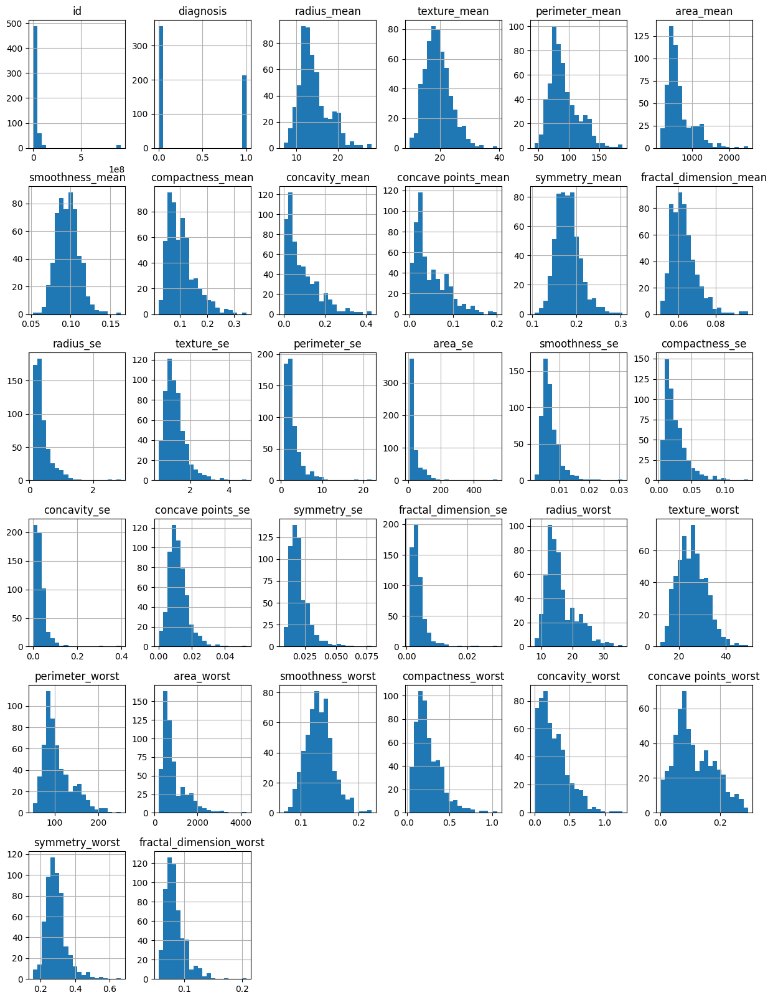

In [ ]:
dataset[numerical_feature].hist(figsize=(15,20),bins=20)
plt.show()

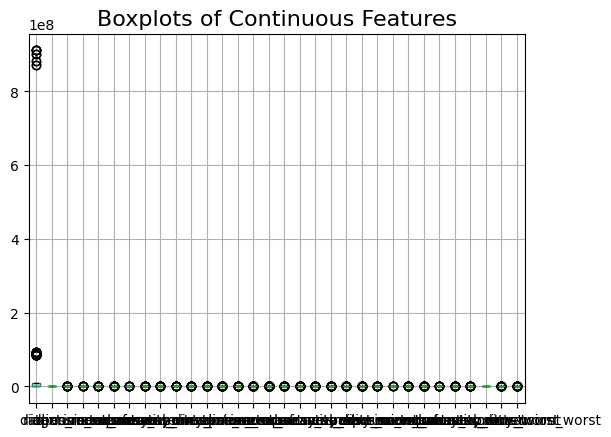

In [ ]:
plt.plot(figsize = (15,20))
dataset.boxplot(numerical_feature)
plt.title("Boxplots of Continuous Features", fontsize=16)
plt.show()

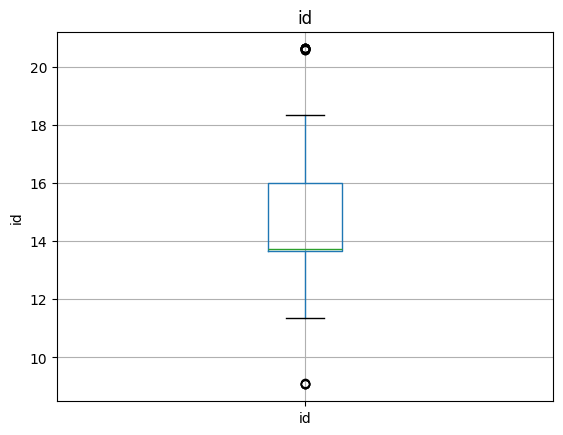

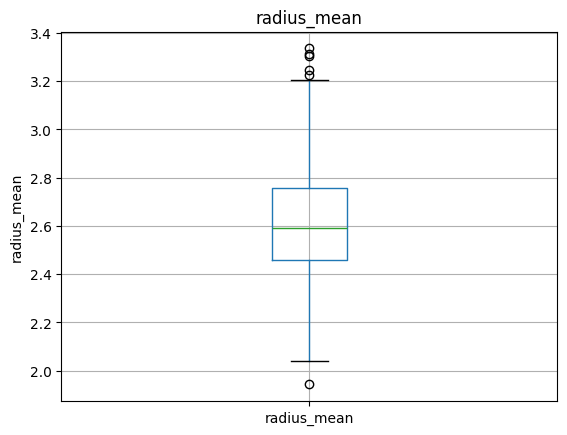

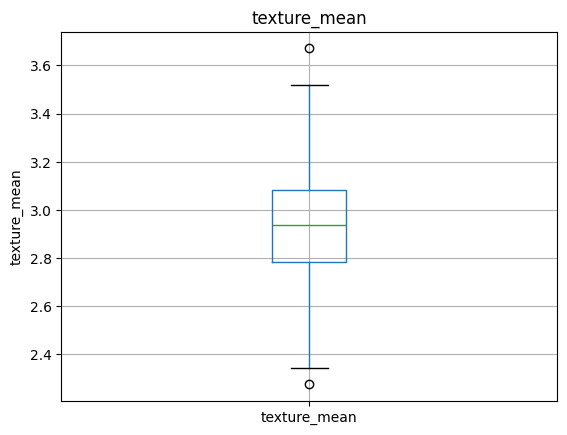

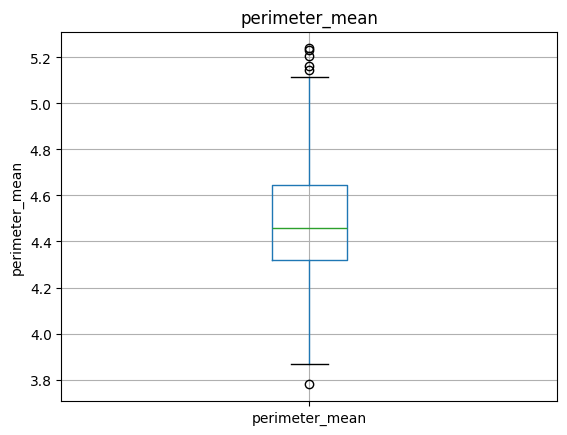

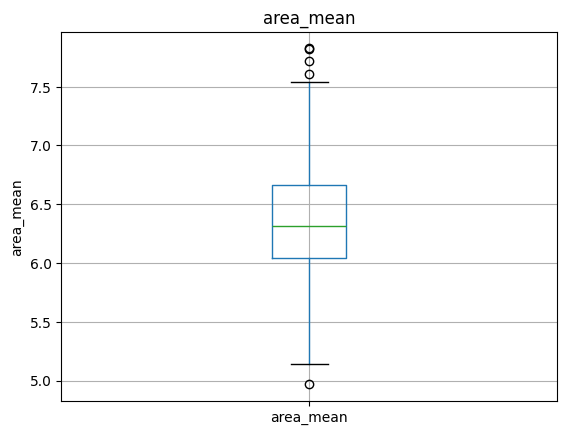

...

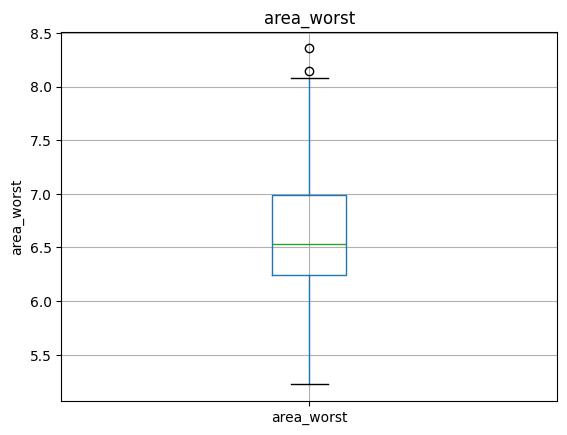

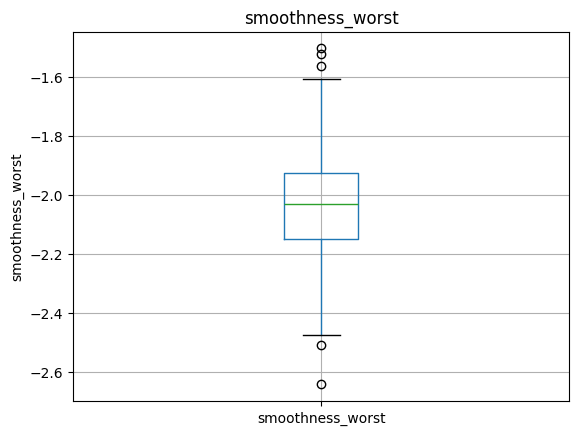

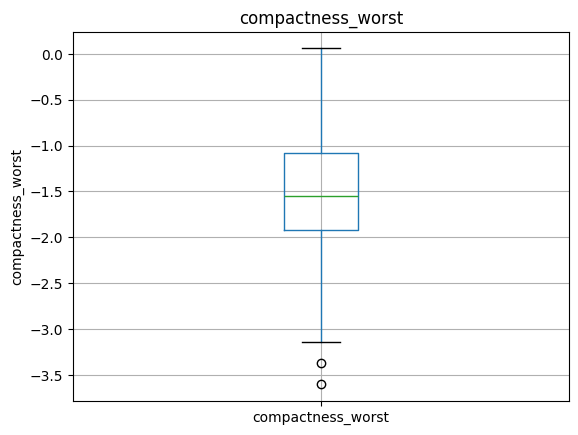

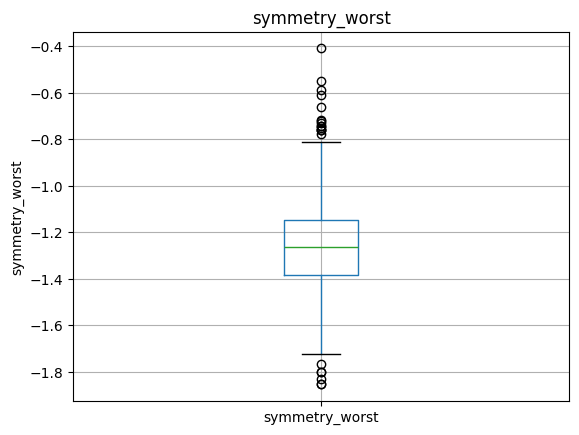

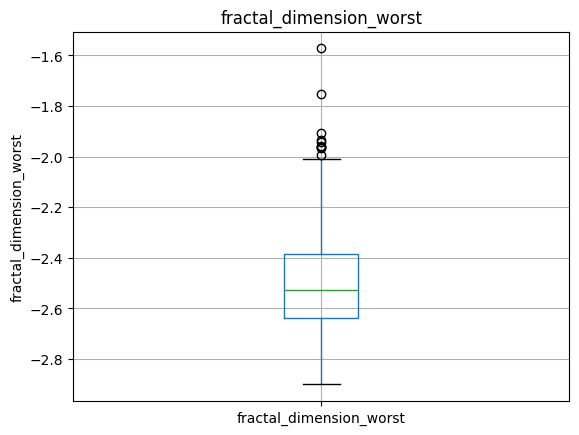

In [ ]:
for feature in numerical_feature:
  data = dataset.copy()
  if 0 in data[feature].unique():
    pass
  else:
    data[feature] = np.log(data[feature])
    data.boxplot(column=feature)
    plt.ylabel(feature)
    plt.title(feature)
    plt.show()


In [ ]:
categorical_features=[feature for feature in dataset.columns if data[feature].dtypes=='O']
categorical_features


[]

drop id as its of no use in prediction


In [ ]:
# Drop the 'id' column
# dataset = dataset.drop(columns=['id'],axis= 1)

# Verify
print(dataset.columns[:10])   # show first 10 columns
print("Shape after dropping id:", dataset.shape)

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean'],
      dtype='object')
Shape after dropping id: (569, 32)


In [ ]:
X = dataset.drop(['id','diagnosis'], axis=1)

In [ ]:
y = dataset['diagnosis']

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
scalar = StandardScaler()

In [ ]:
X_train = scalar.fit_transform(X_train)
X_test = scalar.transform(X_test)

In [ ]:
from sklearn.linear_model import LogisticRegression
Classification = LogisticRegression()

In [ ]:
from sklearn.model_selection import GridSearchCV
parameter = {'penalty':['l1','l2','elasticnet'], 'C':[1,2,3,4,5,6,10,20,30,40,50],'max_iter':[100,200,300]}

In [ ]:
classifier_regressor = GridSearchCV(Classification, parameter, scoring='accuracy', cv=5)

In [ ]:
classifier_regressor.fit(X_train,y_train)

/usr/local/lib/python3.12/dist-packages/sklearn/model_selection/_validation.py:528: FitFailedWarning: 
330 fits failed out of a total of 495.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
165 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/sklearn/model_selection/_validation.py", line 866, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.12/dist-packages/sklearn/base.py", line 1389, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/sklearn/linear_model/_logistic.py", line 1193, in fit
    solver = _check_sol

GridSearchCV(cv=5, estimator=LogisticRegression(),
             param_grid={'C': [1, 2, 3, 4, 5, 6, 10, 20, 30, 40, 50],
                         'max_iter': [100, 200, 300],
                         'penalty': ['l1', 'l2', 'elasticnet']},
             scoring='accuracy')

In [ ]:
print(classifier_regressor.best_params_)

{'C': 3, 'max_iter': 100, 'penalty': 'l2'}


In [ ]:
print(classifier_regressor.best_score_)

0.9780219780219781


In [ ]:
y_pred = classifier_regressor.predict(X_test)

In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [ ]:
score = accuracy_score(y_pred,y_test)

In [ ]:
print(score)

0.9736842105263158


In [ ]:
report = classification_report(y_pred,y_test)
print(report)

              precision    recall  f1-score   support

           0       0.99      0.97      0.98        72
           1       0.95      0.98      0.96        42

    accuracy                           0.97       114
   macro avg       0.97      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114



In [ ]:
matrix = confusion_matrix(y_pred,y_test)
print(matrix)

[[70  2]
 [ 1 41]]


In [ ]:
sns.pairplot(dataset,hue='diagnosis')

In [ ]:
scalar_feature = scalar.transform(dataset.drop(['id','diagnosis'],axis = 1))

In [ ]:
scalar_feature


array([[ 1.09638851, -2.06627179,  1.27258268, ...,  2.31736261,
         2.68853795,  1.96497709],
       [ 1.8268678 , -0.33206493,  1.68830121, ...,  1.10058378,
        -0.24574757,  0.28898778],
       [ 1.57771207,  0.48458457,  1.56893649, ...,  1.97408999,
         1.12231748,  0.20821721],
       ...,
       [ 0.70283571,  2.08737656,  0.67575905, ...,  0.42323335,
        -1.08909705, -0.31791331],
       [ 1.83536175,  2.38071331,  1.98465502, ...,  2.31123274,
         1.87372285,  2.25103952],
       [-1.80004685,  1.25664689, -1.80949689, ..., -1.74980492,
        -0.05393312, -0.75598146]])

In [ ]:
df_feat = pd.DataFrame(scalar_feature,columns = dataset.columns[2:])

In [ ]:
df_feat

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1.096389,-2.066272,1.272583,0.977632,1.629024,3.319431,2.660626,2.599274,2.214413,2.215177,2.450010,-0.549544,2.769907,2.401827,-0.193247,1.259237,0.651080,0.632407,1.158462,0.852186,1.902817,-1.354423,2.324583,2.013959,1.330082,2.666287,2.090691,2.317363,2.688538,1.964977
1,1.826868,-0.332065,1.688301,1.894280,-0.791218,-0.476588,-0.025172,0.575778,0.003690,-0.845175,0.500210,-0.866276,0.260882,0.720762,-0.577727,-0.675522,-0.442964,0.239544,-0.818760,-0.103609,1.821668,-0.350865,1.550691,1.902858,-0.335347,-0.427152,-0.157742,1.100584,-0.245748,0.288988
2,1.577712,0.484585,1.568936,1.547364,0.996281,1.073796,1.366858,2.094255,0.939696,-0.384178,1.214724,-0.768337,0.834608,1.143571,-0.274793,0.776085,0.171171,1.381549,0.236003,0.269585,1.526203,-0.000940,1.361717,1.467269,0.558086,1.109235,0.840499,1.974090,1.122317,0.208217
3,-0.763786,0.280422,-0.588684,-0.756664,3.361878,3.439630,1.921150,1.497175,2.862697,4.815921,0.330862,-0.086273,0.283599,-0.272151,0.694594,2.633368,0.740771,1.077757,4.784595,1.935133,-0.275720,0.159168,-0.246959,-0.545433,3.394520,3.962432,1.971170,2.196298,5.917679,4.999482
4,1.747591,-1.136981,1.778854,1.812487,0.327587,0.556747,1.374416,1.473502,-0.007236,-0.545249,1.255735,-0.778685,1.246898,1.152261,1.474034,-0.055172,0.749179,1.106387,-0.369169,0.464983,1.311887,-1.463362,1.352718,1.230958,0.254493,-0.308322,0.599544,0.740454,-0.857652,-0.397562
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,2.107168,0.752108,2.062859,2.325809,1.096945,0.234307,1.952644,2.383589,-0.309526,-0.906271,2.736381,0.098518,2.327166,2.514152,1.084314,0.176181,0.596580,2.011402,-1.155648,0.150336,1.917383,0.142662,1.769660,2.028067,0.410627,-0.267636,0.650700,1.646142,-1.339566,-0.713353
565,1.702290,2.127270,1.618329,1.710950,0.147830,-0.004184,0.694148,1.305426,-0.214833,-1.031240,1.285080,2.328946,1.133313,1.249750,-0.399569,-0.075617,0.207919,0.777146,-0.195212,-0.475008,1.551172,2.098611,1.436707,1.506066,-0.647615,-0.390986,0.224248,0.745051,-0.527921,-0.981466
566,0.702836,2.087377,0.675759,0.574590,-0.804880,-0.025172,0.045501,0.124680,-0.804844,-0.871557,0.192272,-0.235954,0.273932,0.179693,-0.355685,0.628127,0.450832,0.584691,-0.905738,0.025698,0.571142,1.416917,0.587825,0.435612,-0.764715,0.365905,0.314128,0.423233,-1.089097,-0.317913
567,1.835362,2.380713,1.984655,1.722232,1.585883,3.307983,3.306880,2.728159,2.134288,1.027972,1.145429,0.724960,1.408334,0.978050,-0.152965,1.933928,1.194208,0.754878,0.326657,0.849313,1.977724,2.291730,2.324583,1.664783,1.451520,3.974056,3.174988,2.311233,1.873723,2.251040


In [ ]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=1)

In [ ]:
knn.fit(X_train,y_train)

KNeighborsClassifier(n_neighbors=1)

In [ ]:
pred = knn.predict(X_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix

In [ ]:
print(confusion_matrix(y_test,pred))

[[68  3]
 [ 4 39]]


In [ ]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       0.94      0.96      0.95        71
           1       0.93      0.91      0.92        43

    accuracy                           0.94       114
   macro avg       0.94      0.93      0.93       114
weighted avg       0.94      0.94      0.94       114



check for suitable value of k for better model prediction


In [ ]:
error_rate = []

for i in range(1,40):
  knn = KNeighborsClassifier(n_neighbors = i)
  knn.fit(X_train,y_train)
  pred_i = knn.predict(X_test)
  error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

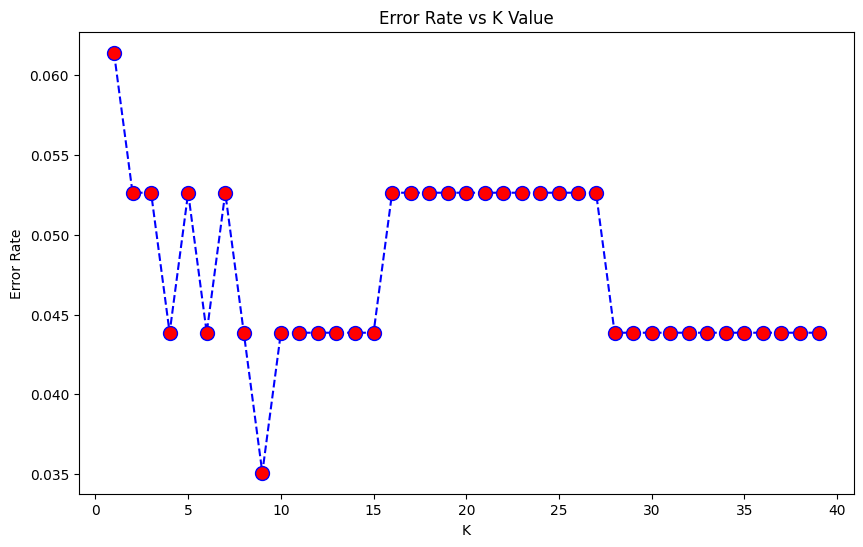

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue',linestyle='dashed',marker='o',markerfacecolor='red',markersize=10)
plt.title('Error Rate vs K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

In [ ]:
knn = KNeighborsClassifier(n_neighbors=30)
knn.fit(X_train,y_train)
pred = knn.predict(X_test)

In [ ]:
from sklearn.metrics import classification_report,confusion_matrix


In [ ]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       0.95      0.99      0.97        71
           1       0.97      0.91      0.94        43

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114

